In [2]:
using CSV, DataFrames, Statistics
df = CSV.read("data/prostate.csv", DataFrame);

In [23]:
using Pkg
Pkg.add("GraphViz")
using GraphViz

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


### EDA

In [3]:
df = df[completecases(df), :];

In [4]:
X = select(df, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
times = df.dtime;
times[times .== 0] .= 1

died = Bool.(df[:,"died"]);

treatments = df[:, "rx"];

In [5]:
(train_X, train_treatments, train_died, train_times), (test_X, test_treatments, test_died, test_times) =
    IAI.split_data(:prescription_maximize, df, treatments, died, times, seed=2345, train_proportion=0.5);

In [6]:
train_X_full = copy(train_X)
test_X_full = copy(test_X);

In [7]:
(train_X, train_treatments, train_died, train_times), (test_X, test_treatments, test_died, test_times) =
    IAI.split_data(:prescription_maximize, X, treatments, died, times, seed=2345, train_proportion=0.5);

In [8]:
train_rewards = CSV.read("data/train_rewards_doubly.csv", DataFrame);
test_rewards = CSV.read("data/test_rewards_doubly.csv", DataFrame);

In [9]:
train_X_with_rewards = hcat(train_X_full, train_rewards)
test_X_with_rewards = hcat(test_X_full, test_rewards);

In [10]:
names(train_X_with_rewards)

23-element Vector{String}:
 "patno"
 "stage"
 "rx"
 "dtime"
 "status"
 "age"
 "wt"
 "pf"
 "hx"
 "sbp"
 "dbp"
 "ekg"
 "hg"
 "sz"
 "sg"
 "ap"
 "bm"
 "sdate"
 "died"
 "0.2 mg estrogen"
 "1.0 mg estrogen"
 "5.0 mg estrogen"
 "placebo"

In [11]:
treatment_mapping = Dict("0.2 mg estrogen" => 1, "1.0 mg estrogen" => 2, "5.0 mg estrogen" => 3, "placebo" => 4)

Dict{String, Int64} with 4 entries:
  "0.2 mg estrogen" => 1
  "1.0 mg estrogen" => 2
  "5.0 mg estrogen" => 3
  "placebo"         => 4

In [12]:
test_rewards

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Float64,Float64,Float64,Float64
1,41.7276,52.9556,65.3164,49.651
2,38.6555,51.2004,37.2089,228.233
3,-81.0782,47.241,37.3177,38.5117
4,35.9735,42.4308,32.6171,39.0772
5,38.4825,49.8288,27.3701,57.4485
6,36.2658,46.4202,-16.671,40.8986
7,42.8094,55.128,40.9195,261.603
8,41.7031,47.2506,9.43795,35.7022
9,34.2966,43.9536,5.57155,30.3546


In [13]:
test_actual_treatment = CSV.read("data/actual_treatments_doubly.csv", DataFrame);
test_policy_treatment = CSV.read("data/policy_treatments_doubly.csv", DataFrame);

In [14]:
test_rewards_ap_treatment = hcat(test_rewards, test_actual_treatment[:,2], test_policy_treatment[:,2], makeunique=true)

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo,x1,x1_1
,Float64,Float64,Float64,Float64,String15,String15
1,41.7276,52.9556,65.3164,49.651,5.0 mg estrogen,5.0 mg estrogen
2,38.6555,51.2004,37.2089,228.233,placebo,5.0 mg estrogen
3,-81.0782,47.241,37.3177,38.5117,0.2 mg estrogen,5.0 mg estrogen
4,35.9735,42.4308,32.6171,39.0772,placebo,5.0 mg estrogen
5,38.4825,49.8288,27.3701,57.4485,placebo,5.0 mg estrogen
6,36.2658,46.4202,-16.671,40.8986,5.0 mg estrogen,1.0 mg estrogen
7,42.8094,55.128,40.9195,261.603,placebo,5.0 mg estrogen
8,41.7031,47.2506,9.43795,35.7022,5.0 mg estrogen,5.0 mg estrogen
9,34.2966,43.9536,5.57155,30.3546,5.0 mg estrogen,5.0 mg estrogen


In [15]:
treatment_mapping["5.0 mg estrogen"]

3

In [16]:
function check_OPT_performance()
    is_better = []
    for i in 1:size(test_rewards_ap_treatment, 1)
        actual_time = test_rewards_ap_treatment[i, treatment_mapping[test_rewards_ap_treatment[i,5]]]
        policy_time = test_rewards_ap_treatment[i, treatment_mapping[test_rewards_ap_treatment[i,6]]]
        policy_time_gain = policy_time - actual_time
        if policy_time_gain > 0
            push!(is_better, 1)
        else
            push!(is_better, 0)
        end
    end
    return is_better
end

check_OPT_performance (generic function with 1 method)

In [17]:
is_better = check_OPT_performance()

238-element Vector{Any}:
 0
 0
 1
 0
 0
 1
 0
 0
 0
 1
 0
 0
 1
 ⋮
 0
 0
 0
 0
 0
 0
 0
 0
 0
 1
 0
 0

In [18]:
(sum(is_better)/238)*100

42.436974789915965

In [19]:
test_rewards_ap_treatment[:, "OPT_better"] = is_better;

In [20]:
test_rewards_ap_treatment

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo,x1,x1_1,OPT_better
,Float64,Float64,Float64,Float64,String15,String15,Any
1,41.7276,52.9556,65.3164,49.651,5.0 mg estrogen,5.0 mg estrogen,0
2,38.6555,51.2004,37.2089,228.233,placebo,5.0 mg estrogen,0
3,-81.0782,47.241,37.3177,38.5117,0.2 mg estrogen,5.0 mg estrogen,1
4,35.9735,42.4308,32.6171,39.0772,placebo,5.0 mg estrogen,0
5,38.4825,49.8288,27.3701,57.4485,placebo,5.0 mg estrogen,0
6,36.2658,46.4202,-16.671,40.8986,5.0 mg estrogen,1.0 mg estrogen,1
7,42.8094,55.128,40.9195,261.603,placebo,5.0 mg estrogen,0
8,41.7031,47.2506,9.43795,35.7022,5.0 mg estrogen,5.0 mg estrogen,0
9,34.2966,43.9536,5.57155,30.3546,5.0 mg estrogen,5.0 mg estrogen,0


In [21]:
grid = IAI.GridSearch(
    IAI.OptimalTreeClassifier(
        random_seed=1,
        criterion=:gini
    ),
    max_depth=3:7,
    minbucket = 0.01
)
IAI.fit!(grid, test_X, is_better)
IAI.get_learner(grid)

┌ Warning: This copy of Interpretable AI software is for academic purposes only and not for commercial use.
└ @ nothing nothing:nothing


Fitted OptimalTreeClassifier:
  1) Split: sg < 10.5
    2) Split: ekg in [heart block or conduction def,heart strain,normal,old MI]
      3) Split: age < 71.5
        4) Split: wt < 82
          5) Predict: 1 (100.00%), [0,2], 2 points, error 0
          6) Predict: 0 (97.44%), [38,1], 39 points, error 0.04997
        7) Split: sbp < 13.5
          8) Predict: 0 (84.00%), [21,4], 25 points, error 0.2688
          9) Predict: 1 (59.46%), [15,22], 37 points, error 0.4821
      10) Predict: 1 (70.59%), [5,12], 17 points, error 0.4152
    11) Split: ap < 3.65
      12) Split: wt < 98.5
        13) Split: sg < 12.5
          14) Predict: 1 (83.33%), [2,10], 12 points, error 0.2778
          15) Predict: 0 (76.92%), [10,3], 13 points, error 0.355
        16) Split: dbp < 8.5
          17) Predict: 0 (86.36%), [19,3], 22 points, error 0.2355
          18) Predict: 1 (66.67%), [6,12], 18 points, error 0.4444
      19) Split: wt < 94.5
        20) Split: age < 77.5
          21) Predict: 1 (93.75%), [1,15], 16 points, error 0.1172
          22) Predict: 0 (75.00%), [3,1], 4 points, error 0.375
        23) Split: wt < 101
          24) Split: sz < 33
            25) Predict: 0 (92.31%), [12,1], 13 points, error 0.142
            26) Predict: 1 (75.00%), [1,3], 4 points, error 0.375
          27) Predict: 1 (75.00%), [4,12], 16 points, error 0.375

In [24]:
best_tree_SG = IAI.get_learner(grid)
IAI.write_png("Results/OCT_SG_Analysis.png", best_tree_SG)

## Analysis for SG High vs Low

In [25]:
using Plots

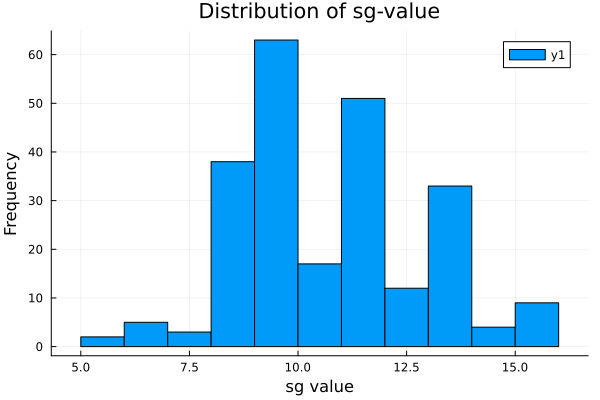

In [26]:
histogram(train_X_full[:, "sg"], xlabel="sg value", ylabel="Frequency", title="Distribution of sg-value")

In [27]:
df[:, "sg_low"] = df[:, "sg"] .< 11;

In [28]:
df_sg_low = filter(:sg_low => n -> n == true, df);
df_sg_high = filter(:sg_low => n -> n == false, df);

### Reward Estimation - With Doubly Robust

In [29]:
propensity = [
        IAI.GridSearch(IAI.RandomForestClassifier(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]), 
        # IAI.GridSearch(IAI.XGBoostClassifier(random_seed = 1), num_round = [20, 50, 100])
        ]
outcome  = [
        IAI.GridSearch(IAI.RandomForestSurvivalLearner(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]),
        # IAI.GridSearch(IAI.XGBoostSurvivalLearner(random_seed = 1), num_round = [20, 50, 100])
        ]
    
train_results_doubly = DataFrame(propensity_model=[], outcome_model=[], train_reward_score = [], test_reward_score = [])

for i in 1:length(propensity)
        reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
                propensity_estimator=propensity[i], 
                outcome_estimator=outcome[i], 
                reward_estimator=:doubly_robust, 
                random_seed=1) 
        
        train_predictions, train_reward_score = IAI.fit_predict!(
                reward_lnr, train_X, train_treatments, train_died, train_times,
                outcome_score_criterion=:harrell_c_statistic,
                propensity_score_criterion=:misclassification)

        test_predictions, test_reward_score = IAI.fit_predict!(
                reward_lnr, test_X, test_treatments, test_died, test_times,
                outcome_score_criterion=:harrell_c_statistic,
                propensity_score_criterion=:misclassification)

        test_rewards = test_predictions[:reward]
        train_rewards = train_predictions[:reward]
        
        push!(train_results_doubly, [propensity[i], outcome[i], train_reward_score, test_reward_score])
end

In [30]:
# select model based on train score!!!
propensity_scores = DataFrame([[],[],[],[]], ["model", "train_propensity_score",  "test_propensity_score", "mean_propensity_score"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(propensity_scores, (
        row.propensity_model, 
        row.train_reward_score[:propensity],
        row.test_reward_score[:propensity],
        (row.train_reward_score[:propensity] + row.test_reward_score[:propensity]) / 2
        ))
end
print(propensity_scores)

1×4 DataFrame
 Row │ model                              train_propensity_score  test_propensity_score  mean_propensity_score
     │ Any                                Any                     Any                    Any
─────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.273404                0.198188               0.235796

In [31]:
# select model based on train score!!!
outcome_scores = DataFrame([[],[],[],[],[],[],[],[],[],[],[],[]], ["model", "train_outcome_score", "test_outcome_score", "mean_outcome_score","train_0.2 mg estrogen", "train_1.0 mg estrogen", "train_5.0 mg estrogen", "train_placebo", "test_0.2 mg estrogen", "test_1.0 mg estrogen", "test_5.0 mg estrogen", "test_placebo"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(outcome_scores, (
        row.outcome_model, 
        mean(values(row[:train_reward_score][:outcome])),
        mean(values(row[:test_reward_score][:outcome])),
        (mean(values(row[:train_reward_score][:outcome])) + mean(values(row[:test_reward_score][:outcome]))) / 2,
        values(row[:train_reward_score][:outcome])..., 
        values(row[:test_reward_score][:outcome])...
        ))
end
print(outcome_scores)

1×12 DataFrame
 Row │ model                              train_outcome_score  test_outcome_score  mean_outcome_score  train_0.2 mg estrogen  train_1.0 mg estrogen  train_5.0 mg estrogen  train_placebo  test_0.2 mg estrogen  test_1.0 mg estrogen  test_5.0 mg estrogen  test_placebo
     │ Any                                Any                  Any                 Any                 Any                    Any                    Any                    Any            Any                   Any                   Any                   Any
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.646212             0.543449            0.594831            0.627131               0.772331               0.587291               0.598094       0.438069

In [32]:
# get final rewards using best estimators
reward = [:doubly_robust] #, :direct_method, :inverse_propensity_weighting]

rewards = Dict()
for rew in reward
    train_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
        propensity_estimator=propensity[1], 
        # outcome_estimator=outcome[2], 
        outcome_estimator=outcome[1], 
        reward_estimator=rew, 
        random_seed=1) 
    
    test_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
    propensity_estimator=propensity[1], 
    outcome_estimator=outcome[1], 
    reward_estimator=rew, 
    random_seed=1) 
        
    train_predictions, train_reward_score = IAI.fit_predict!(
        train_reward_lnr, train_X, train_treatments, train_died, train_times,
        outcome_score_criterion=:harrell_c_statistic,
        propensity_score_criterion=:misclassification)

    test_predictions, test_reward_score = IAI.fit_predict!(
            test_reward_lnr, test_X, test_treatments, test_died, test_times,
            outcome_score_criterion=:harrell_c_statistic,
            propensity_score_criterion=:misclassification)

    test_rewards = test_predictions[:reward]
    train_rewards = train_predictions[:reward]

    rewards[rew] = Dict("train" => train_rewards, "test" => test_rewards)
end

In [33]:
describe(rewards[:doubly_robust]["train"])

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,0.2 mg estrogen,32.5029,-286.277,36.6009,407.406,0,Float64
2,1.0 mg estrogen,37.9289,-207.691,40.1316,411.677,0,Float64
3,5.0 mg estrogen,36.0162,-246.935,39.996,462.405,0,Float64
4,placebo,32.0872,-291.034,38.5219,340.31,0,Float64


### Doubly robust rewards -> optimal policy tree


In [34]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=2,
    ),
    max_depth=2:7,
    minbucket=[5, 10, 25, 50]
    )

tree_doubly_robust = IAI.fit_cv!(grid, train_X, rewards[:doubly_robust]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp           split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp   mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64     Float64     Float64     Float64              Int64
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.022226              0.0374372           0.0453643           0.0465551           0.0472269           0.0392779         0.0431723       0.00449294        -0.041221            -0.0197083          -0.00406056          -0.0428668         -0.0296777        -0.0275069        0.0161188   0.0129241    0.508056     0.00497259   0.00407879   0.508741    0.207755    0.274471             -0.0320982                23
   2 │         5          3  0.0118334             0.0614907           0.0671935           0.0681688           0.0628327           0.0606743         0.064072        0.00340114        -0.0119559           -0.0128192          -0.00990087          -0.0337068         -0.0259363        -0.0188638        0.0104274   0.0104437    0.014465     0.508767     0.0071978    0.01488     0.111151    0.222297             -0.0313015                15
   3 │         5          4  0.00987584            0.077896            0.0898744           0.0828698           0.0788129           0.0799431         0.0818792       0.00484566        -0.00559242          -0.0129521          -0.0066529           -0.025654          -0.0214932        -0.0144689        0.00889704  0.000835253  0.014465     0.000849522  0.0078378    0.0131229   0.0074221   0.0064973            -0.0229477                 8
   4 │         5          5  0.011249              0.091243            0.0992946           0.0993924           0.0876504           0.086714          0.0928589       0.00615637        -0.00529062          -0.0133265          -0.00511562          -0.0328338         -0.0192542        -0.0151642        0.0115194   0.00317678   0.00109788   0.013842     0.00479834   0.00358922  0.00530085  0.00495758           -0.0200814                 4
   5 │         5          6  0.00177523            0.0947238           0.106476            0.0978916           0.0940916           0.0949501         0.0976267       0.00515937         0.0037663           -0.00245008         -0.004445            -0.0350354         -0.0040898        -0.00845079       0.0152239   0.00283806   0.000844313  0.0141178    0.0112355    0.00174018  0.00615517  0.00608099           -0.0185047                 3
   6 │         5          7  0.000184224           0.0993911           0.105478            0.100962            0.0945297           0.0995536         0.0999829       0.00391881         0.000200332         -0.00659207          0.00629617          -0.0299562         -0.0273663        -0.0114836        0.0163559   0.00680641   0.00138568   0.000369194  0.00667436   0.0125839   0.00556391  0.00491171           -0.0155998                 1
   7 │        10          2  0.022226            

In [35]:
best_tree_all_DR = IAI.get_learner(tree_doubly_robust)
IAI.write_png("Results/OPT_All_DR.png", best_tree_all_DR)

In [36]:
test_rewards = rewards[:doubly_robust]["test"]
policy_outcomes = IAI.predict_outcomes(tree_doubly_robust, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 83
Policy gave best treatment (in %): 34.87
Actually gave best treatment: 95
Actually gave best treatment (in %): 39.92



In [37]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 5
Policy gave best treatment (in %): 8.2
Actually gave best treatment: 23
Actually gave best treatment (in %): 37.7

Oracle treatment: placebo
Policy gave best treatment: 10
Policy gave best treatment (in %): 16.95
Actually gave best treatment: 23
Actually gave best treatment (in %): 38.98

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 55
Policy gave best treatment (in %): 93.22
Actually gave best treatment: 25
Actually gave best treatment (in %): 42.37

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 13
Policy gave best treatment (in %): 22.03
Actually gave best treatment: 24
Actually gave best treatment (in %): 40.68



In [38]:
actual_survival

18.47557084294549

In [39]:
policy_survival

41.58434339138289

In [40]:
oracle_survival

82.94901724056855

In [41]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 5
Policy gave best treatment (in %): 8.2
Actually gave best treatment: 23
Actually gave best treatment (in %): 37.7

Oracle treatment: placebo
Policy gave best treatment: 10
Policy gave best treatment (in %): 16.95
Actually gave best treatment: 23
Actually gave best treatment (in %): 38.98

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 55
Policy gave best treatment (in %): 93.22
Actually gave best treatment: 25
Actually gave best treatment (in %): 42.37

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 13
Policy gave best treatment (in %): 22.03
Actually gave best treatment: 24
Actually gave best treatment (in %): 40.68



In [42]:
# do same analysis as above grouped by stage
for stage in unique(test_X[:, "stage"])
    println("Stage: ", stage)
    println("Policy gave best treatment: ", sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println()
end

Stage: 3
Policy gave best treatment: 41
Policy gave best treatment (in %): 30.15
Actually gave best treatment: 60
Actually gave best treatment (in %): 44.12

Stage: 4
Policy gave best treatment: 42
Policy gave best treatment (in %): 41.18
Actually gave best treatment: 35
Actually gave best treatment (in %): 34.31



In [43]:
# do same analysis as above by died
for died in unique(test_died)
    println("Died: ", died)
    println("Policy gave best treatment: ", sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println()
end

Died: true
Policy gave best treatment: 64
Policy gave best treatment (in %): 36.57
Actually gave best treatment: 38
Actually gave best treatment (in %): 21.71

Died: false
Policy gave best treatment: 19
Policy gave best treatment (in %): 30.16
Actually gave best treatment: 57
Actually gave best treatment (in %): 90.48



In [44]:
# do same analysis as above by test_treatments
for treatment in unique(test_treatments)
    println("Actual reatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Actual reatment: 5.0 mg estrogen
Policy gave best treatment: 21
Policy gave best treatment (in %): 34.43
Actually gave best treatment: 23
Actually gave best treatment (in %): 37.7

Actual reatment: placebo
Policy gave best treatment: 17
Policy gave best treatment (in %): 28.81
Actually gave best treatment: 23
Actually gave best treatment (in %): 38.98

Actual reatment: 0.2 mg estrogen
Policy gave best treatment: 25
Policy gave best treatment (in %): 42.37
Actually gave best treatment: 24
Actually gave best treatment (in %): 40.68

Actual reatment: 1.0 mg estrogen
Policy gave best treatment: 20
Policy gave best treatment (in %): 33.9
Actually gave best treatment: 25
Actually gave best treatment (in %): 42.37



### Trying out the Prescriptive Tree

In [41]:
grid = IAI.GridSearch(
    IAI.OptimalTreePrescriptionMaximizer(
        prescription_factor=0.5,
        treatment_minbucket=25,
        random_seed=1,
        max_categoric_levels_before_warning=15
    ),
    max_depth=1:5,
)
IAI.fit_cv!(grid, train_X, train_treatments, train_times)
IAI.get_learner(grid)


# tree_doubly_robust = IAI.fit_cv!(grid, train_X, rewards[:doubly_robust]["train"])

Fitted OptimalTreePrescriptionMaximizer:
  1) Split: hx < 0.5
    2) Prescribe: 5.0 mg estrogen, 134 points, error 0.003777
    3) Prescribe: placebo, 103 points, error 0.00384

In [42]:
test_rewards = rewards[:doubly_robust]["test"]
prescription_outcomes = IAI.predict_outcomes(IAI.get_learner(grid), test_X)

actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

# policy_treatments = IAI.predict_treatment_rank(IAI.get_learner(grid), test_X)[:, 1]
# oracle_treatments = argmax.(eachrow(test_rewards));

# policy_survival = mean(policy_outcomes)
# actual_survival = mean(actual_outcomes)
# oracle_survival = mean(oracle_outcomes)

# # convert oracle_treatments from symbol to strings
# oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

# println("Overall")
# # convert oracle_treatments from symbol to strings
# println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
# println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# # compare test_treatments and oracle_treatments
# println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
# println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
# println()

In [43]:
mean(maximum.(eachrow(prescription_outcomes)))

40.98797165925195

### Reward Estimation - With Direct Method

In [105]:
# propensity = [
#         IAI.GridSearch(IAI.RandomForestClassifier(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]), 
#         # IAI.GridSearch(IAI.XGBoostClassifier(random_seed = 1), num_round = [20, 50, 100])
#         ]
outcome  = [
        IAI.GridSearch(IAI.RandomForestSurvivalLearner(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]),
        IAI.GridSearch(IAI.XGBoostSurvivalLearner(random_seed = 1), num_round = [20, 50, 100])
        ]
    
train_results_doubly = DataFrame(outcome_model=[], train_reward_score = [], test_reward_score = [])

for i in 1:length(outcome)
        reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#                 propensity_estimator=propensity[i], 
                outcome_estimator=outcome[i], 
                reward_estimator=:direct_method, 
                random_seed=1) 
        
        train_predictions, train_reward_score = IAI.fit_predict!(
                reward_lnr, train_X, train_treatments, train_died, train_times,
                outcome_score_criterion=:harrell_c_statistic,
#                 propensity_score_criterion=:misclassification
    )

        test_predictions, test_reward_score = IAI.fit_predict!(
                reward_lnr, test_X, test_treatments, test_died, test_times,
                outcome_score_criterion=:harrell_c_statistic,
#                 propensity_score_criterion=:misclassification
    )

        test_rewards = test_predictions[:reward]
        train_rewards = train_predictions[:reward]
        
#         push!(train_results_doubly, [propensity[i], outcome[i], train_reward_score, test_reward_score])
        push!(train_results_doubly, [outcome[i], train_reward_score, test_reward_score])
end

In [106]:
# # select model based on train score!!!
# propensity_scores = DataFrame([[],[],[],[]], ["model", "train_propensity_score",  "test_propensity_score", "mean_propensity_score"])
# for (i, row) in enumerate(eachrow(train_results_doubly))
#     push!(propensity_scores, (
#         row.propensity_model, 
#         row.train_reward_score[:propensity],
#         row.test_reward_score[:propensity],
#         (row.train_reward_score[:propensity] + row.test_reward_score[:propensity]) / 2
#         ))
# end
# print(propensity_scores)

In [107]:
train_results_doubly

Row,outcome_model,train_reward_score,test_reward_score
,Any,Any,Any
1,"GridSearch - Unfitted RandomForestSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_trees=100,)\n (num_trees=200,)\n (num_trees=400,)\n (num_trees=600,)\n (num_trees=800,)\n (num_trees=1000,)","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.493333, String15(""5.0 mg estrogen"")=>0.584737, String15(""placebo"")=>0.580952), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.627131, String15(""1.0 mg estrogen"")=>0.772331, String15(""5.0 mg estrogen"")=>0.587291, String15(""placebo"")=>0.598094))","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.533248, String15(""5.0 mg estrogen"")=>NaN, String15(""placebo"")=>0.498095), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.438069, String15(""1.0 mg estrogen"")=>0.510166, String15(""5.0 mg estrogen"")=>0.567956, String15(""placebo"")=>0.657607))"
2,"GridSearch - Unfitted XGBoostSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_round=20,)\n (num_round=50,)\n (num_round=100,)","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.512381, String15(""5.0 mg estrogen"")=>0.612456, String15(""placebo"")=>0.380952), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.501266, String15(""1.0 mg estrogen"")=>0.695316, String15(""5.0 mg estrogen"")=>0.617374, String15(""placebo"")=>0.599182))","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.575641, String15(""5.0 mg estrogen"")=>NaN, String15(""placebo"")=>0.546667), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.521057, String15(""1.0 mg estrogen"")=>0.498777, String15(""5.0 mg estrogen"")=>0.48985, String15(""placebo"")=>0.637077))"


In [108]:
# select model based on train score!!!
outcome_scores = DataFrame([[],[],[],[],[],[],[],[],[],[],[],[]], ["model", "train_outcome_score", "test_outcome_score", "mean_outcome_score","train_0.2 mg estrogen", "train_1.0 mg estrogen", "train_5.0 mg estrogen", "train_placebo", "test_0.2 mg estrogen", "test_1.0 mg estrogen", "test_5.0 mg estrogen", "test_placebo"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(outcome_scores, (
        row.outcome_model, 
        mean(values(row[:train_reward_score][:outcome])),
        mean(values(row[:test_reward_score][:outcome])),
        (mean(values(row[:train_reward_score][:outcome])) + mean(values(row[:test_reward_score][:outcome]))) / 2,
        values(row[:train_reward_score][:outcome])..., 
        values(row[:test_reward_score][:outcome])...
        ))
end
print(outcome_scores)

2×12 DataFrame
 Row │ model                              train_outcome_score  test_outcome_score  mean_outcome_score  train_0.2 mg estrogen  train_1.0 mg estrogen  train_5.0 mg estrogen  train_placebo  test_0.2 mg estrogen  test_1.0 mg estrogen  test_5.0 mg estrogen  test_placebo
     │ Any                                Any                  Any                 Any                 Any                    Any                    Any                    Any            Any                   Any                   Any                   Any
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.646212             0.543449            0.594831            0.627131               0.772331               0.587291               0.598094       0.438069

In [109]:
outcome_scores

Row,model,train_outcome_score,test_outcome_score,mean_outcome_score,train_0.2 mg estrogen,train_1.0 mg estrogen,train_5.0 mg estrogen,train_placebo,test_0.2 mg estrogen,test_1.0 mg estrogen,test_5.0 mg estrogen,test_placebo
,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any
1,"GridSearch - Unfitted RandomForestSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_trees=100,)\n (num_trees=200,)\n (num_trees=400,)\n (num_trees=600,)\n (num_trees=800,)\n (num_trees=1000,)",0.646212,0.543449,0.594831,0.627131,0.772331,0.587291,0.598094,0.438069,0.510166,0.567956,0.657607
2,"GridSearch - Unfitted XGBoostSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_round=20,)\n (num_round=50,)\n (num_round=100,)",0.603285,0.536691,0.569988,0.501266,0.695316,0.617374,0.599182,0.521057,0.498777,0.48985,0.637077


In [110]:
# get final rewards using best estimators
reward = [:direct_method] #, :direct_method, :inverse_propensity_weighting]

rewards = Dict()
for rew in reward
    train_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#         propensity_estimator=propensity[1], 
        outcome_estimator=outcome[2], 
#         outcome_estimator=outcome[1], 
        reward_estimator=rew, 
        random_seed=1) 
    
    test_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#     propensity_estimator=propensity[1], 
    outcome_estimator=outcome[2], 
#     outcome_estimator=outcome[1], 
    reward_estimator=rew, 
    random_seed=1) 
        
    train_predictions, train_reward_score = IAI.fit_predict!(
        train_reward_lnr, train_X, train_treatments, train_died, train_times,
        outcome_score_criterion=:harrell_c_statistic,
#         propensity_score_criterion=:misclassification
    )

    test_predictions, test_reward_score = IAI.fit_predict!(
            test_reward_lnr, test_X, test_treatments, test_died, test_times,
            outcome_score_criterion=:harrell_c_statistic,
#             propensity_score_criterion=:misclassification
    )

    test_rewards = test_predictions[:reward]
    train_rewards = train_predictions[:reward]

    rewards[rew] = Dict("train" => train_rewards, "test" => test_rewards)
end

In [111]:
describe(rewards[:direct_method]["train"])

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,0.2 mg estrogen,60.904,5.32081,68.2537,74.9538,0,Float64
2,1.0 mg estrogen,66.1093,7.9913,72.9459,74.9807,0,Float64
3,5.0 mg estrogen,66.6737,7.0859,74.1376,74.9737,0,Float64
4,placebo,63.0675,4.23133,70.8775,74.9822,0,Float64


### Doubly robust rewards -> optimal policy tree


In [112]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=2,
    ),
    max_depth=2:7,
    minbucket=[5, 10, 25, 50]
    )

tree_direct_method = IAI.fit_cv!(grid, train_X, rewards[:direct_method]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp          split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp   split2_cp  split3_cp   split4_cp   split5_cp   mean_cp    std_cp     overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64     Float64    Float64     Float64     Float64     Float64    Float64    Float64              Int64
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.0193887             0.661359            0.671481            0.712673            0.644466            0.673289          0.672654        0.0251269            0.695411            0.655767           0.206239             0.673672            0.559608          0.558139        0.203444   0.133972    0.298745   0.0247368   0.0323993   0.0193887   0.101848   0.119759              0.553633                 2
   2 │         5          3  0.00331776            0.724673            0.711903            0.755               0.701808            0.736563          0.725989        0.0208466            0.586846            0.658679           0.321793             0.531408            0.532903          0.526326        0.125582   0.198543    0.0084094  0.00428976  0.0130378   0.00651391  0.0461587  0.0852461             0.50276                  9
   3 │         5          4  0.0262164             0.748403            0.742062            0.771596            0.736832            0.757353          0.751249        0.0137079            0.513591            0.599287           0.318619             0.445872            0.381968          0.451867        0.109794   0.0731108   0.0499217  0.0031444   0.0128476   0.0403655   0.035878   0.0283087             0.413962                16
   4 │         5          5  0.00675944            0.755652            0.752483            0.77617             0.734181            0.769178          0.757533        0.0162581            0.440109            0.573517           0.2769               0.474918            0.420114          0.437112        0.10724    0.00706781  0.0399514  0.00614824  0.0140847   0.00911853  0.0152741  0.0141324             0.417462                15
   5 │         5          6  0.0122528             0.763901            0.753916            0.787607            0.740848            0.780796          0.765414        0.0191512            0.442588            0.50593            0.261826             0.480878            0.378287          0.413902        0.0976901  0.0699246   0.0214386  0.00451708  0.0126083   0.0100198   0.0237017  0.0265518             0.396555                17
   6 │         5          7  0.00802682            0.764346            0.755355            0.788161            0.756639            0.775735          0.768047        0.013862             0.468809            0.486082           0.209117             0.426163            0.360252          0.390085        0.112198   0.00665562  0.0631111  0.00172314  0.0237006   0.00761428  0.020561   0.0251804             0.369255                18
   7 │        10          2  0.0193887             0.64286             0.654317            0.712673            0.622471  

In [ ]:
best_tree_all_DM = IAI.get_learner(tree_direct_method)
IAI.write_png("Results/OPT_All_DM.png", best_tree_all_DM)

In [113]:
test_rewards = rewards[:direct_method]["test"]
policy_outcomes = IAI.predict_outcomes(tree_direct_method, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_direct_method, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 61
Policy gave best treatment (in %): 25.63
Actually gave best treatment: 65
Actually gave best treatment (in %): 27.31



In [114]:
sum(policy_treatments .== oracle_treatments)

61

In [115]:
freqtable(oracle_treatments)

4-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
0.2 mg estrogen │ 49
1.0 mg estrogen │ 59
5.0 mg estrogen │ 57
placebo         │ 73

In [116]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[oracle_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[oracle_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: placebo
Policy gave best treatment: 8
Policy gave best treatment (in %): 10.96
Actually gave best treatment: 22
Actually gave best treatment (in %): 30.14

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 34
Policy gave best treatment (in %): 59.65
Actually gave best treatment: 14
Actually gave best treatment (in %): 24.56

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 4
Policy gave best treatment (in %): 6.78
Actually gave best treatment: 16
Actually gave best treatment (in %): 27.12

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 15
Policy gave best treatment (in %): 30.61
Actually gave best treatment: 13
Actually gave best treatment (in %): 26.53



In [117]:
actual_survival

66.03789830335026

In [118]:
policy_survival

66.80009003838084

In [119]:
oracle_survival

74.47973723392239

In [120]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: placebo
Policy gave best treatment: 8
Policy gave best treatment (in %): 13.56
Actually gave best treatment: 22
Actually gave best treatment (in %): 37.29

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 34
Policy gave best treatment (in %): 55.74
Actually gave best treatment: 14
Actually gave best treatment (in %): 22.95

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 4
Policy gave best treatment (in %): 6.78
Actually gave best treatment: 16
Actually gave best treatment (in %): 27.12

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 15
Policy gave best treatment (in %): 25.42
Actually gave best treatment: 13
Actually gave best treatment (in %): 22.03



In [121]:
# do same analysis as above grouped by stage
for stage in unique(test_X[:, "stage"])
    println("Stage: ", stage)
    println("Policy gave best treatment: ", sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println()
end

Stage: 3
Policy gave best treatment: 32
Policy gave best treatment (in %): 23.53
Actually gave best treatment: 39
Actually gave best treatment (in %): 28.68

Stage: 4
Policy gave best treatment: 29
Policy gave best treatment (in %): 28.43
Actually gave best treatment: 26
Actually gave best treatment (in %): 25.49



In [122]:
# do same analysis as above by died
for died in unique(test_died)
    println("Died: ", died)
    println("Policy gave best treatment: ", sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println()
end

Died: true
Policy gave best treatment: 49
Policy gave best treatment (in %): 28.0
Actually gave best treatment: 45
Actually gave best treatment (in %): 25.71

Died: false
Policy gave best treatment: 12
Policy gave best treatment (in %): 19.05
Actually gave best treatment: 20
Actually gave best treatment (in %): 31.75



In [123]:
# do same analysis as above by test_treatments
for treatment in unique(test_treatments)
    println("Actual reatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Actual reatment: 5.0 mg estrogen
Policy gave best treatment: 15
Policy gave best treatment (in %): 24.59
Actually gave best treatment: 14
Actually gave best treatment (in %): 22.95

Actual reatment: placebo
Policy gave best treatment: 13
Policy gave best treatment (in %): 22.03
Actually gave best treatment: 22
Actually gave best treatment (in %): 37.29

Actual reatment: 0.2 mg estrogen
Policy gave best treatment: 20
Policy gave best treatment (in %): 33.9
Actually gave best treatment: 13
Actually gave best treatment (in %): 22.03

Actual reatment: 1.0 mg estrogen
Policy gave best treatment: 13
Policy gave best treatment (in %): 22.03
Actually gave best treatment: 16
Actually gave best treatment (in %): 27.12



### Finding an OPT for sg_high patients

In [124]:
train_X

Row,stage,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm
,Int64,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64
1,3,75,76,normal activity,0,15,9,heart strain,13.7988,2,8,0.299988,0
2,3,75,94,in bed < 50% daytime,1,14,7,benign,17.5977,4,8,0.899902,0
3,3,60,110,normal activity,0,12,8,normal,14.5996,4,10,0.699951,0
4,3,78,107,normal activity,1,13,8,old MI,13.0,21,6,0.399963,0
5,3,77,89,normal activity,0,15,8,normal,15.5996,3,8,0.599976,0
6,3,74,105,normal activity,1,18,14,normal,13.5996,6,8,0.399963,0
7,3,74,107,normal activity,0,14,9,old MI,14.3984,6,9,0.299988,0
8,3,55,112,normal activity,1,16,9,heart strain,13.8984,4,9,1.0,0
9,3,87,81,in bed < 50% daytime,1,17,12,rhythmic disturb & electrolyte ch,13.3984,3,9,0.399963,0


In [125]:
train_X_full_rewards = hcat(train_X_full, train_rewards)
test_X_full_rewards = hcat(test_X_full, test_rewards);

In [126]:
train_sg_low_rewards = filter(row -> row.patno in df_sg_low.patno, train_X_full_rewards)
train_sg_high_rewards = filter(row -> row.patno in df_sg_high.patno, train_X_full_rewards)

Row,patno,stage,rx,dtime,status,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm,sdate,died,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Int64,Int64,String15,Int64,String31,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64,Int64,Int64,Float64,Float64,Float64,Float64
1,25,4,1.0 mg estrogen,42,dead - cerebrovascular,73,103,normal activity,0,16,10,normal,14.5996,6,11,3.8999,0,2831,1,69.2995,74.7529,74.8681,71.7766
2,30,4,0.2 mg estrogen,8,dead - prostatic ca,76,90,normal activity,0,15,9,heart strain,12.7988,40,13,2.2998,0,2895,1,5.63554,41.2377,74.5443,41.5143
3,31,4,0.2 mg estrogen,13,dead - prostatic ca,74,77,in bed > 50% daytime,0,16,9,heart strain,10.5,17,13,316.0,1,2905,1,46.9378,73.9695,74.0754,68.7036
4,33,4,1.0 mg estrogen,9,dead - prostatic ca,71,88,normal activity,1,16,9,heart strain,12.2988,38,13,35.3984,0,2932,1,41.822,35.4736,73.2542,43.1461
5,34,4,placebo,21,dead - prostatic ca,79,89,normal activity,0,16,9,heart strain,12.7988,26,12,12.0996,0,2940,1,70.5221,22.0787,60.9776,10.1221
6,35,4,5.0 mg estrogen,66,dead - prostatic ca,75,101,normal activity,0,15,9,normal,14.5996,8,14,3.7998,0,2953,1,69.9488,74.6688,74.7916,73.8949
7,37,4,placebo,27,dead - other specific non-ca,72,93,normal activity,0,16,10,heart strain,13.0,2,11,1.2998,0,2933,1,73.9173,74.8887,74.3302,74.5864
8,38,4,0.2 mg estrogen,2,dead - heart or vascular,69,84,normal activity,1,12,8,benign,10.3984,15,13,28.8984,1,2979,1,67.2621,70.749,69.4397,70.2214
9,39,4,0.2 mg estrogen,20,dead - prostatic ca,53,99,normal activity,0,12,9,benign,14.1992,26,13,5.59961,1,3050,1,63.9398,72.476,74.8852,72.7908


In [127]:
test_sg_low_rewards = filter(row -> row.patno in df_sg_low.patno, test_X_full_rewards)
test_sg_high_rewards = filter(row -> row.patno in df_sg_high.patno, test_X_full_rewards)

Row,patno,stage,rx,dtime,status,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm,sdate,died,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Int64,Int64,String15,Int64,String31,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64,Int64,Int64,Float64,Float64,Float64,Float64
1,6,3,0.2 mg estrogen,24,dead - prostatic ca,71,98,normal activity,0,19,10,normal,15.0996,10,11,0.599976,0,3086,1,62.5008,75.3787,75.6401,74.0926
2,24,4,5.0 mg estrogen,31,dead - prostatic ca,56,95,normal activity,0,15,10,rhythmic disturb & electrolyte ch,14.7988,26,13,35.6953,1,2791,1,72.5077,71.5531,74.9611,53.412
3,26,4,0.2 mg estrogen,38,dead - heart or vascular,69,75,normal activity,0,16,8,heart strain,10.6992,25,11,6.19922,0,2861,1,61.5442,60.134,73.935,19.3618
4,28,4,placebo,39,dead - prostatic ca,71,103,normal activity,0,12,7,normal,14.3984,11,11,12.0,0,2873,1,75.8609,75.9343,72.6005,54.8966
5,29,4,1.0 mg estrogen,33,dead - other ca,66,126,normal activity,0,17,10,heart strain,14.0,32,13,24.1992,0,2884,1,64.9412,71.08,74.1214,65.2159
6,32,4,5.0 mg estrogen,33,dead - other specific non-ca,71,150,normal activity,1,16,10,old MI,15.0,9,11,1.8999,0,2924,1,67.9428,75.337,73.8084,74.332
7,36,4,5.0 mg estrogen,5,dead - prostatic ca,76,86,normal activity,1,16,6,heart strain,8.19922,10,11,99.1875,1,2953,1,50.7641,35.4275,75.8178,46.9193
8,40,4,1.0 mg estrogen,19,dead - prostatic ca,76,85,normal activity,0,14,9,heart strain,13.0,6,11,1.3999,1,3141,1,73.8849,24.6469,74.1112,64.3709
9,43,4,5.0 mg estrogen,32,dead - prostatic ca,82,89,normal activity,0,14,8,normal,13.0,27,13,22.2969,1,3204,1,21.9839,55.5949,74.9522,53.7605


In [128]:
train_sg_high = select(train_sg_high_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
test_sg_high = select(test_sg_high_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
train_sg_low = select(train_sg_low_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
test_sg_low = select(test_sg_low_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));

In [129]:
train_sg_high_rewards_only = train_sg_high[:,14:end]
test_sg_high_rewards_only = test_sg_high[:,14:end]
train_sg_low_rewards_only = train_sg_low[:,14:end]
test_sg_low_rewards_only = test_sg_low[:,14:end]

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Float64,Float64,Float64,Float64
1,65.259,73.402,59.4922,74.5119
2,38.4202,72.4483,72.5363,75.3419
3,60.2864,71.2038,75.3251,75.7055
4,28.0826,74.5986,67.383,75.0375
5,46.5894,75.061,62.7026,72.0402
6,71.682,75.8098,75.7488,73.7453
7,73.9849,65.6341,41.7751,23.4586
8,70.429,49.5344,67.7607,38.0243
9,74.4658,13.6512,49.5841,68.7186


In [130]:
train_sg_high = train_sg_high[:,1:13]
test_sg_high = test_sg_high[:,1:13]
train_sg_low = train_sg_low[:,1:13]
test_sg_low = test_sg_low[:,1:13]

Row,stage,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm
,Int64,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64
1,3,69,102,normal activity,1,14,8,heart strain,13.3984,3,9,0.299988,0
2,3,67,99,normal activity,0,17,10,normal,13.3984,34,8,0.5,0
3,3,75,100,normal activity,0,14,10,benign,13.0,13,9,0.799927,0
4,3,73,114,normal activity,1,17,11,heart strain,12.5996,3,9,0.599976,0
5,3,73,88,normal activity,0,19,10,heart strain,12.0,15,10,0.599976,0
6,3,64,90,normal activity,0,14,8,normal,16.1992,6,9,0.699951,0
7,3,83,72,in bed < 50% daytime,1,13,9,heart strain,15.0,1,10,0.699951,0
8,4,76,82,normal activity,0,12,8,old MI,11.6992,12,10,2.5,0
9,3,78,118,normal activity,1,16,9,heart strain,12.3984,3,9,0.399963,0


In [131]:
train_times = train_sg_high_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_high_rewards[:,"died"]);
train_treatments = train_sg_high_rewards[:, "rx"];

In [132]:
test_times = test_sg_high_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_high_rewards[:,"died"]);
test_treatments = test_sg_high_rewards[:, "rx"];

In [133]:
train_times

109-element Vector{Int64}:
 42
  8
 13
  9
 21
 66
 27
  2
 20
 60
 43
 21
 14
  ⋮
 37
 22
 18
 33
 30
  7
  9
 59
  7
 50
 14
 27

In [134]:
test_times

118-element Vector{Int64}:
 24
 31
 38
 39
 33
 33
  5
 19
 32
 53
 53
 72
  7
  ⋮
 13
  1
 26
 22
 53
 61
 40
 46
  1
  5
  1
 19

In [135]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=1,
    ),
    max_depth=2:5,
    minbucket=[5, 10, 25, 50]
    )

tree_doubly_robust = IAI.fit_cv!(grid, train_sg_high, train_sg_high_rewards_only)
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp         split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp  split2_cp   split3_cp  split4_cp  split5_cp  mean_cp    std_cp     overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64    Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64    Float64     Float64    Float64    Float64    Float64    Float64    Float64              Int64
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.146872             0.674148            0.685591            0.669202            0.680509            0.723095          0.686509        0.021376             0.563933            0.613598            0.167107            0.629446          0.0253306           0.399883         0.282736  0.203225   0.113398    0.100662   0.113418   0.312415   0.168624   0.090263              0.399314                 7
   2 │         5          3  0.054593             0.730626            0.727168            0.707584            0.712086            0.748625          0.725218        0.0163122            0.401239            0.623227            0.386933            0.341773          0.118376            0.374309         0.179865  0.029151   0.0327633   0.0409428  0.10366    0.0137631  0.044056   0.0347478             0.352969                10
   3 │         5          4  0.0541154            0.716846            0.737632            0.72095             0.735286            0.753904          0.732923        0.014746             0.522214            0.55263             0.292701            0.263174          0.0811982           0.342384         0.195897  0.0523644  0.0823997   0.0592589  0.0893559  0.0137631  0.0594284  0.029827              0.319301                12
   4 │         5          5  0.0141064            0.731432            0.739262            0.724034            0.743422            0.771126          0.741855        0.0179734            0.396366            0.623579            0.392348            0.315651          0.0907788           0.363744         0.191193  0.013176   0.0137319   0.068381   0.0540664  0.139835   0.057838   0.0519347             0.332781                11
   5 │        10          2  0.0168815            0.666545            0.683531            0.669202            0.680509            0.721966          0.684351        0.0222307            0.608175            0.650581            0.167107            0.589788         -0.00177417          0.402776         0.299069  0.0637638  0.113398    0.100662   0.0168815  0.641744   0.18729    0.256803              0.394216                 8
   6 │        10          3  0.043013             0.683936            0.710043            0.677239            0.690476            0.724458          0.697231        0.0195417            0.619742            0.630891            0.329489            0.467621         -0.00177417          0.409194         0.260836  0.0436351  0.0494889   0.0809589  0.0273611  0.641744   0.168638   0.265188              0.394147                 9
   7 │        10          4  0.0137939            0.681032            0.701526            0.691896            0.690476            0.724458          0.697878 

In [136]:
test_X = test_sg_high
test_rewards = test_sg_high_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 29
Policy gave best treatment (in %): 24.58
Actually gave best treatment: 35
Actually gave best treatment (in %): 29.66



In [137]:
policy_survival

63.70339740906437

In [138]:
actual_survival

62.56193333005506

In [139]:
oracle_survival

73.85804834635663

In [140]:
train_times = train_sg_low_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_low_rewards[:,"died"]);
train_treatments = train_sg_low_rewards[:, "rx"];

In [141]:
test_times = test_sg_low_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_low_rewards[:,"died"]);
test_treatments = test_sg_low_rewards[:, "rx"];

In [142]:
train_times

128-element Vector{Int64}:
 72
 20
 61
 60
 60
 59
 59
 49
  3
 29
 26
 52
 51
  ⋮
  1
  7
 70
 65
 64
 13
  1
 53
 12
 52
 19
 41

In [143]:
test_times

120-element Vector{Int64}:
 40
 65
 46
 62
 20
 58
 20
 69
  3
 74
 54
 73
 36
  ⋮
 40
 67
 36
 23
 62
  4
 56
 52
 51
 51
 51
 53

In [144]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=1,
    ),
    max_depth=2:5,
    minbucket=[5, 10, 25, 50]
    )

tree_doubly_robust = IAI.fit_cv!(grid, train_sg_low, train_sg_low_rewards_only)
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp         split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp   split2_cp  split3_cp   split4_cp  split5_cp  mean_cp    std_cp     overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64    Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64     Float64    Float64     Float64    Float64    Float64    Float64    Float64              Int64
─────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.0498948            0.691141            0.663574            0.702063            0.656509            0.685483          0.679754        0.0191201           0.412267             0.714562            0.281162            0.583008          -0.0967512          0.37885          0.312746  0.0626531   0.0781781  0.0498948   0.059774   0.212447   0.0925893  0.0677667             0.375219                 1
   2 │         5          3  0.0671873            0.740718            0.690716            0.737453            0.72055             0.743938          0.726675        0.0220338           0.380292             0.466975            0.290356            0.459048           0.0716968          0.333674         0.162918  0.0401335   0.0671873  0.0424765   0.112706   0.0815188  0.0688043  0.0300281             0.306718                 3
   3 │         5          4  0.0591827            0.753799            0.722387            0.753731            0.73876             0.766669          0.747069        0.016971            0.305639             0.218452            0.18058             0.4162             0.147548           0.253684         0.108352  0.048251    0.211595   0.00193927  0.202021   0.0774919  0.10826    0.0939696             0.209166                 9
   4 │         5          5  0.0523224            0.756959            0.728189            0.758812            0.732647            0.764269          0.748175        0.0165065           0.276938             0.323504            0.234086            0.381602          -0.0401629          0.235193         0.163401  0.0450211   0.043573   0.0168332   0.192458   0.0198217  0.0635414  0.0732365             0.18138                 16
   5 │        10          2  0.0932464            0.651679            0.576404            0.672572            0.604869            0.673094          0.635724        0.0432428           0.45637              0.491431            0.320256            0.414955          -0.0967512          0.317252         0.240128  0.0611743   0.177084   0.116514    0.125214   0.209349   0.137867   0.0573269             0.313067                 2
   6 │        10          3  0.105902             0.686631            0.653146            0.695939            0.651788            0.717121          0.680925        0.0282343           0.373071             0.378023            0.251962            0.398973          -0.0721495          0.265976         0.197634  0.0305231   0.101142   0.0933071   0.137108   0.172516   0.106919   0.0530786             0.254322                 8
   7 │        10          4  0.11287              0.689701            0.680145            0.695939            0.661045            0.683025          

In [145]:
test_X = test_sg_low
test_rewards = test_sg_low_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 24
Policy gave best treatment (in %): 20.0
Actually gave best treatment: 30
Actually gave best treatment (in %): 25.0



In [146]:
policy_survival

66.72131295114211

In [147]:
actual_survival

69.45593052709053

In [148]:
oracle_survival

75.09106464002872

In [149]:
freqtable(test_sg_low_rewards[:, "rx"])

4-element Named Vector{Int64}
Dim1                        │ 
────────────────────────────┼───
String15("0.2 mg estrogen") │ 28
String15("1.0 mg estrogen") │ 30
String15("5.0 mg estrogen") │ 31
String15("placebo")         │ 31

In [150]:
freqtable(policy_treatments)

3-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
1.0 mg estrogen │ 11
5.0 mg estrogen │ 86
placebo         │ 23

#### On Complete Dataset

In [217]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=100,
    ),
    max_depth=2:5,
    minbucket=[5]
    )

tree_doubly_robust_complete = IAI.fit_cv!(grid, train_X, rewards[:doubly_robust]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp          split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp   split2_cp   split3_cp  split4_cp  split5_cp    mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64     Float64     Float64    Float64    Float64      Float64     Float64     Float64              Int64
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.0047635            0.0409845           0.0401832           0.0485757            0.049529           0.0381867         0.0434918       0.00518824          0.00321596           0.0189411          0.0                0.0101968            0.00652315       0.00777541        0.00730326  0.00508581  0.0047635   0.509172   0.0155521  0.00550373   0.108015    0.224299             0.0022626                  1
   2 │         5          3  0.00311902           0.0608985           0.0654193           0.0702733            0.069207           0.0610331         0.0653663       0.00440371          0.0216227           -0.0210126          0.00483417         0.000962573         -0.0232146       -0.00336156        0.0188135   0.00184015  0.00606119  0.0014192  0.0127529  0.00330007   0.00507469  0.00466105          -0.00769774                 2
   3 │         5          4  0.00613164           0.076579            0.0841695           0.0871889            0.091357           0.079826          0.0838241       0.00584512          0.0174477           -0.0303425          0.0               -0.00144964          -0.0104897       -0.00496684        0.0174204   0.00611035  0.00651545  0.513989   0.013856   0.000126741  0.108119    0.22694             -0.0129761                  4
   4 │         5          5  0.00732384           0.0928705           0.0958087           0.0999813            0.102692           0.0917411         0.0966187       0.00465521          0.0237452           -0.0192038          0.0               -0.0037948           -0.00202344      -0.000255357       0.0154174   0.00674988  0.0103387   0.509659   0.013856   0.00293427   0.108707    0.224175            -0.0112276                  3

Best Params:
  minbucket => 5
  cp => 0.004763498551913714
  max_depth => 2

Best Model - Fitted OptimalTreePolicyMaximizer:
  1) Split: hg < 12.65
    2) Split: hg < 11.85
      3) Prescribe: 1.0 mg estrogen, 46 points, error 410.1
      4) Prescribe: 0.2 mg estrogen, 28 points, error 396.8
    5) Split: age < 76.5
      6) Prescribe: 5.0 mg estrogen, 134 points, error 407.6
      7) Prescribe: 0.2 mg estrogen, 29 points, error 416.3

In [184]:
test_sg_low

Row,stage,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm
,Int64,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64
1,3,69,102,normal activity,1,14,8,heart strain,13.3984,3,9,0.299988,0
2,3,67,99,normal activity,0,17,10,normal,13.3984,34,8,0.5,0
3,3,75,100,normal activity,0,14,10,benign,13.0,13,9,0.799927,0
4,3,73,114,normal activity,1,17,11,heart strain,12.5996,3,9,0.599976,0
5,3,73,88,normal activity,0,19,10,heart strain,12.0,15,10,0.599976,0
6,3,64,90,normal activity,0,14,8,normal,16.1992,6,9,0.699951,0
7,3,83,72,in bed < 50% daytime,1,13,9,heart strain,15.0,1,10,0.699951,0
8,4,76,82,normal activity,0,12,8,old MI,11.6992,12,10,2.5,0
9,3,78,118,normal activity,1,16,9,heart strain,12.3984,3,9,0.399963,0


In [185]:
test_treatments

120-element PooledArrays.PooledVector{String15, UInt32, Vector{UInt32}}:
 "5.0 mg estrogen"
 "placebo"
 "placebo"
 "placebo"
 "5.0 mg estrogen"
 "placebo"
 "5.0 mg estrogen"
 "placebo"
 "0.2 mg estrogen"
 "placebo"
 "0.2 mg estrogen"
 "5.0 mg estrogen"
 "placebo"
 ⋮
 "1.0 mg estrogen"
 "1.0 mg estrogen"
 "0.2 mg estrogen"
 "placebo"
 "0.2 mg estrogen"
 "1.0 mg estrogen"
 "placebo"
 "placebo"
 "1.0 mg estrogen"
 "5.0 mg estrogen"
 "1.0 mg estrogen"
 "1.0 mg estrogen"

In [229]:
test_X = test_sg_low
test_rewards = test_sg_low_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust_complete, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust_complete, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 19
Policy gave best treatment (in %): 15.83
Actually gave best treatment: 59
Actually gave best treatment (in %): 49.17



In [230]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 9
Policy gave best treatment (in %): 29.03
Actually gave best treatment: 13
Actually gave best treatment (in %): 41.94

Oracle treatment: placebo
Policy gave best treatment: 0
Policy gave best treatment (in %): 0.0
Actually gave best treatment: 17
Actually gave best treatment (in %): 54.84

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 7
Policy gave best treatment (in %): 23.33
Actually gave best treatment: 14
Actually gave best treatment (in %): 46.67

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 3
Policy gave best treatment (in %): 10.71
Actually gave best treatment: 15
Actually gave best treatment (in %): 53.57



In [231]:
actual_survival

42.85580364555638

In [232]:
policy_survival

43.60494155194503

In [233]:
oracle_survival

96.7196674686364

In [234]:
freqtable(policy_treatments)

3-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
0.2 mg estrogen │ 24
1.0 mg estrogen │ 19
5.0 mg estrogen │ 77

In [223]:
train_times = train_sg_high_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_high_rewards[:,"died"]);
train_treatments = train_sg_high_rewards[:, "rx"];

In [224]:
test_times = test_sg_high_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_high_rewards[:,"died"]);
test_treatments = test_sg_high_rewards[:, "rx"];

In [225]:
test_X = test_sg_high
test_rewards = test_sg_high_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust_complete, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust_complete, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 30
Policy gave best treatment (in %): 25.42
Actually gave best treatment: 36
Actually gave best treatment (in %): 30.51



In [226]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 15
Policy gave best treatment (in %): 51.72
Actually gave best treatment: 11
Actually gave best treatment (in %): 37.93

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 10
Policy gave best treatment (in %): 32.26
Actually gave best treatment: 9
Actually gave best treatment (in %): 29.03

Oracle treatment: placebo
Policy gave best treatment: 0
Policy gave best treatment (in %): 0.0
Actually gave best treatment: 6
Actually gave best treatment (in %): 21.43

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 5
Policy gave best treatment (in %): 16.67
Actually gave best treatment: 10
Actually gave best treatment (in %): 33.33



In [188]:
actual_survival

42.85580364555638

In [189]:
policy_survival

43.28951270521686

In [190]:
oracle_survival

96.7196674686364

In [195]:
countmap(df_sg_high[:, "rx"])

LoadError: UndefVarError: countmap not defined

In [204]:
combine(groupby(df, [:rx]), nrow)

Row,rx,nrow
,String15,Int64
1,0.2 mg estrogen,118
2,5.0 mg estrogen,121
3,placebo,119
4,1.0 mg estrogen,117


In [201]:
import Pkg; Pkg.add("FreqTables")

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
   Installed FreqTables ──── v0.4.5
   Installed Combinatorics ─ v1.0.2
   Installed NamedArrays ─── v0.9.6
    Updating `~/.julia/environments/v1.8/Project.toml`
  [da1fdf0e] + FreqTables v0.4.5
    Updating `~/.julia/environments/v1.8/Manifest.toml`
  [861a8166] + Combinatorics v1.0.2
  [da1fdf0e] + FreqTables v0.4.5
  [86f7a689] + NamedArrays v0.9.6
Precompiling project...
  ✓ NamedArrays
  ✓ FreqTables
  2 dependencies successfully precompiled in 4 seconds. 124 already precompiled. 1 skipped during auto due to previous errors.


In [95]:
using FreqTables

In [203]:
freqtable(policy_treatments)

2-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
1.0 mg estrogen │ 22
5.0 mg estrogen │ 98

### Direct method -> months as results



In [159]:
# training the optimal policy tree
tree_direct = IAI.fit_cv!(grid, train_X, rewards[:direct_method]["train"])

All Grid Results:

 Row │ max_depth  cp         split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp  split2_cp   split3_cp  split4_cp  split5_cp  mean_cp    std_cp      overall_valid_score  rank_valid_score 
     │ Int64      Float64    Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64    Float64     Float64    Float64    Float64    Float64    Float64     Float64              Int64            
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         2  0.0222899            0.511896            0.560175            0.565879            0.561184            0.502895          0.540406        0.0303781            0.338895            0.230023           0.293782             0.279996            0.202347          0.269009        0.0538102  0.060383   0.0222899   0.0249864  0.0332677  0.106483   0.049482   0.0352502              0.26666                  2
   2 │         3  0.0218355            0.584874            0.642237            0.634768            0.655075            0.571773          0.617745        0.0370038            0.316025            0.346422           0.157216             0.22713             0.41326           0.29201         0.100769   0.0651357  0.00392531  0.02642    0.0371177  0.0205247  0.0306247  0.0227251              0.268188                 1
   3 │         4  0.0128446            0.599746            0.659917            0.662848            0.685758            0.593887          0.640431        0.0411047            0.416732            0.300899           0.134616             0.117749            0.298963          0.253792        0.126016   0.0413143  0.0196729   0.0240175  0.043934   0.0123114  0.02825    0.0138039              0.232893                 3
   4 │         5  0.0167022            0.616557            0.669937            0.668821            0.695817            0.609067          0.65204         0.0374968            0.346851            0.234091           0.0918854            0.182854            0.281333          0.227403        0.0969157  0.0400366  0.0165626   0.0251033  0.0166082  0.0218117  0.0240245  0.00965828             0.209273                 4

Best Params:
  cp => 0.021835509465736785
  max_depth => 3

Best Model - Fitted OptimalTreePolicyMaximizer:
  1) Split: age < 76.5
    2) Split: sg < 9.5
      3) Split: hg < 14.15
        4) Prescribe: placebo, 45 points, error 2.282
        5) Prescribe: 5.0 mg estrogen, 39 points, error 1.318
      6) Split: hg < 12.1
        7) Prescribe: 1.0 mg estrogen, 30 points, error 5.132
        8) Prescribe: 5.0 mg estrogen, 78 points, error 2.779
    9) Split: ap < 1.65
      10) Prescribe: placebo, 33 points, error 6.552
      11) Prescribe: 0.2 mg estrogen, 12 points, error 6.727

In [158]:
test_rewards = rewards[:direct_method]["test"]

policy_outcomes = IAI.predict_outcomes(tree_direct, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

actual_survival = mean(actual_outcomes)
policy_survival = mean(policy_outcomes)
oracle_survival = mean(oracle_outcomes)

# calculate MSE
# policy vs. oracle
mse_policy = mean((oracle_outcomes .- policy_outcomes).^2)

# actual vs. oracle
mse_actual = mean((oracle_outcomes .- actual_outcomes).^2)

# mse improvement in %
mse_improvement = (mse_actual - mse_policy) / mse_actual * 100

println("Policy survival: ", round(policy_survival, digits=2))
println("Actual survival: ", round(actual_survival, digits=2))
println("Oracle survival: ", round(oracle_survival, digits=2))
println("Improvement (month): ", round(policy_survival - actual_survival, digits=2))
println("Improvement (month in %): ", round((policy_survival - actual_survival) / actual_survival * 100, digits=2))
println("MSE policy: ", round(mse_policy, digits=2))
println("MSE actual: ", round(mse_actual, digits=2))
println("MSE improvement in %: ", round(mse_improvement, digits=2))

Policy survival: 65.73
Actual survival: 65.82
Oracle survival: 73.89
Improvement (month): -0.09
Improvement (month in %): -0.14
MSE policy: 256.71
MSE actual: 260.02
MSE improvement in %: 1.27
